# Exploratory Data Analysis: Food Environment Atlas

In this notebook, I perform an Exploratory Data Analysis (EDA) of the Food Environment Atlas (FEA) data.
FEA contains stats on food environment indicators to stimulate research on the determinancts of food choice and diet quality. This data can be used by governments, researchers, policymakers, etc. to provide an overview of a community's ability to access healthy food.

The data and a data training webinar can be found at the site below. I utilized the dataset last updated on 9/10/2020.

Data: https://www.ers.usda.gov/data-products/food-environment-atlas/

Data Training Webinar: https://www.ers.usda.gov/newsroom/trending-topics/data-training-webinars/#FARA_FEA



## Tutorials

Here's a list of tutorials from around the web that I've used (and plan to use) to help with different parts of this notebook.

#### Loading Data

Dictionaries: https://www.w3schools.com/python/python_dictionaries.asp
Joining Dataframes: https://www.datacamp.com/tutorial/joining-dataframes-pandas

#### Map Plot

Cloropleths with plotly: https://plotly.com/python/choropleth-maps/#base-map-configuration


#### Correlation

Tutorial 1: https://data36.com/correlation-definition-calculation-corr-pandas/

Tutorial 2: https://www.statology.org/how-to-read-a-correlation-matrix/

#### SQL in Pandas
https://www.datacamp.com/tutorial/how-to-use-sql-in-pandas-using-pandasql-queries

#### Boolean Indexing
Extracting column values based on another column

https://saturncloud.io/blog/how-to-extract-column-values-based-on-another-column-in-pandas/

#### EDA

https://towardsdatascience.com/exploratory-data-analysis-8fc1cb20fd15


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd

## Load Food Environment Atlas Data

In [2]:
#Names of sheets in excel data file
sheets = ['ACCESS','STORES','RESTAURANTS','ASSISTANCE','INSECURITY','TAXES','LOCAL','HEALTH','SOCIOECONOMIC']

#Number of sheets as a range
num_sheets=range(len(sheets))

#Store each sheet as a dataframe in a dictionary
#The key is the name of the sheet in lower case. The value is the contents of the sheet stored as a dataframe
fea_dict={}
keys = [sheets[i].lower() for i in num_sheets]
for i in num_sheets:
    fea_dict[keys[i]]=pd.read_excel('data/FoodEnvironmentAtlas.xlsx',sheet_name=sheets[i],converters={'FIPS': str}) 

#conveert FIPS to string so that leading zero remains



Tutorial for how to join dataframes: https://www.datacamp.com/tutorial/joining-dataframes-pandas

In [3]:
#Join dataframes into one using an inner join. Join on the columns: FIPS, State, County
fea = fea_dict[keys[0]]
i=1 #initialize counter
while i<len(num_sheets):
    fea = pd.merge(fea, fea_dict[keys[i]], on=['FIPS','State','County'], how='inner')
    i+=1

In [4]:
#Make a copy of the single joined dataframe
fea_data=fea.copy()

In [5]:
#List column names
list(fea_data.columns)

['FIPS',
 'State',
 'County',
 'LACCESS_POP10',
 'LACCESS_POP15',
 'PCH_LACCESS_POP_10_15',
 'PCT_LACCESS_POP10',
 'PCT_LACCESS_POP15',
 'LACCESS_LOWI10',
 'LACCESS_LOWI15',
 'PCH_LACCESS_LOWI_10_15',
 'PCT_LACCESS_LOWI10',
 'PCT_LACCESS_LOWI15',
 'LACCESS_HHNV10',
 'LACCESS_HHNV15',
 'PCH_LACCESS_HHNV_10_15',
 'PCT_LACCESS_HHNV10',
 'PCT_LACCESS_HHNV15',
 'LACCESS_SNAP15',
 'PCT_LACCESS_SNAP15',
 'LACCESS_CHILD10',
 'LACCESS_CHILD15',
 'LACCESS_CHILD_10_15',
 'PCT_LACCESS_CHILD10',
 'PCT_LACCESS_CHILD15',
 'LACCESS_SENIORS10',
 'LACCESS_SENIORS15',
 'PCH_LACCESS_SENIORS_10_15',
 'PCT_LACCESS_SENIORS10',
 'PCT_LACCESS_SENIORS15',
 'LACCESS_WHITE15',
 'PCT_LACCESS_WHITE15',
 'LACCESS_BLACK15',
 'PCT_LACCESS_BLACK15',
 'LACCESS_HISP15',
 'PCT_LACCESS_HISP15',
 'LACCESS_NHASIAN15',
 'PCT_LACCESS_NHASIAN15',
 'LACCESS_NHNA15',
 'PCT_LACCESS_NHNA15',
 'LACCESS_NHPI15',
 'PCT_LACCESS_NHPI15',
 'LACCESS_MULTIR15',
 'PCT_LACCESS_MULTIR15',
 'GROC11',
 'GROC16',
 'PCH_GROC_11_16',
 'GROCPTH11',

In [6]:
#check if columns are duplicated
fea_data.columns.duplicated()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [7]:
#determine size of dataset
print('Number of Rows:',fea_data.shape[0])
print('Number of Columns:',fea_data.shape[1])

Number of Rows: 3143
Number of Columns: 284


## Diabetes Investigation

Taking a look at our potential target variable, diabetes.

Cloropleths with plotly: https://plotly.com/python/choropleth-maps/#base-map-configuration

In [8]:
#consider a data frame containing only the diabetes data
targets=['FIPS','State','County','PCT_DIABETES_ADULTS08','PCT_DIABETES_ADULTS13']
fea_data_diabetes=fea_data[targets]

In [9]:
fea_data_diabetes.shape

(3143, 5)

In [10]:
fea_data_diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3143 entries, 0 to 3142
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   FIPS                   3143 non-null   object 
 1   State                  3143 non-null   object 
 2   County                 3143 non-null   object 
 3   PCT_DIABETES_ADULTS08  3138 non-null   float64
 4   PCT_DIABETES_ADULTS13  3142 non-null   float64
dtypes: float64(2), object(3)
memory usage: 122.9+ KB


In [11]:
#Drop nulls from diabetes dataframe (Note: this was not done on full dataset)
fea_data_diabetes=fea_data_diabetes.dropna()

In [12]:
fea_data_diabetes.shape

(3137, 5)

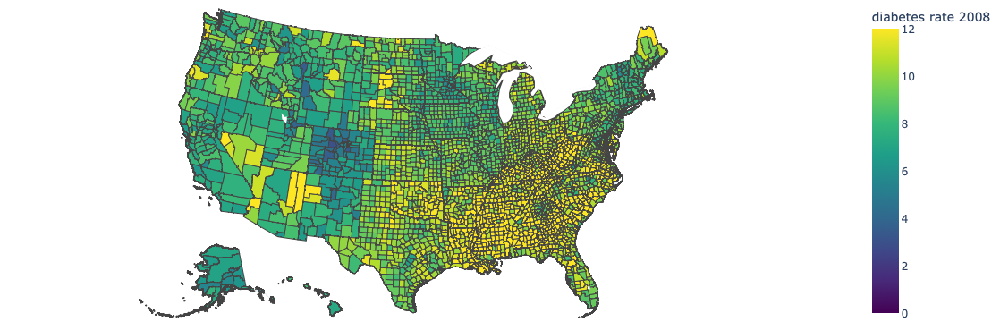

In [13]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


# Create basic choropleth map
fig = px.choropleth(fea_data_diabetes, geojson=counties, locations='FIPS', color='PCT_DIABETES_ADULTS08',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'PCT_DIABETES_ADULTS08':'diabetes rate 2008'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [14]:
## Stats
d8_mean=fea_data_diabetes.PCT_DIABETES_ADULTS08.mean()
d8_median=fea_data_diabetes.PCT_DIABETES_ADULTS08.median()

print('PCT_DIABETES_ADULTS08 Stats')
print('')
print('Mean:',d8_mean)
print('Median:',d8_median)

PCT_DIABETES_ADULTS08 Stats

Mean: 9.91240038253108
Median: 9.8


In [15]:
## Boolean indexing
#List all states with counties that have PCT_DIABETES_ADULTS08 greater than the mean
fea_data_diabetes.loc[fea_data_diabetes['PCT_DIABETES_ADULTS08'] > d8_mean, 'State'].unique()

array(['AL', 'AZ', 'AR', 'DE', 'FL', 'GA', 'HI', 'ID', 'IL', 'IN', 'KS',
       'KY', 'LA', 'ME', 'MD', 'MA', 'MI', 'MS', 'MO', 'MT', 'NE', 'NV',
       'NJ', 'NM', 'NY', 'NC', 'ND', 'OH', 'OK', 'OR', 'PA', 'SC', 'SD',
       'TN', 'TX', 'VA', 'WA', 'WV', 'WI', 'WY'], dtype=object)

In [16]:
## Additional Questions (not an exhaustive list)

#Which states have the highest percentage of counties with diabetes rates larger than the mean?
#Comparing 2008 and 2013 diabetes data, which counties had a shift in diabetes rates (up or down)?

## EDA with Full Dataset

#### Correlation

It’s a good practice to remove correlated variables during feature selection.

Pearson Correlation

The Pearson correlation measures the strength of the linear relationship between two variables. It has a value between -1 to 1

In [17]:
#Consider numeric columns only
fea_data_numeric=fea_data.select_dtypes([np.number])


In [18]:
#Linear Correlation Matrix
fea_data_numeric.corr().style.background_gradient(cmap='coolwarm') #default method is pearson

/opt/anaconda3/lib/python3.11/site-packages/pandas/io/formats/style.py:3819: RuntimeWarning:

All-NaN slice encountered

/opt/anaconda3/lib/python3.11/site-packages/pandas/io/formats/style.py:3820: RuntimeWarning:

All-NaN slice encountered



In [19]:
fea_data_numeric.SNAP_REPORTSIMPLE16.info()
fea_data_numeric.SNAP_REPORTSIMPLE16.unique()

<class 'pandas.core.series.Series'>
RangeIndex: 3143 entries, 0 to 3142
Series name: SNAP_REPORTSIMPLE16
Non-Null Count  Dtype
--------------  -----
3143 non-null   int64
dtypes: int64(1)
memory usage: 24.7 KB


array([1])

## EDA with Subset of Data

Consider a subset of the full set of data

In [20]:
#List column names from full dataset
list(fea_data.columns)

['FIPS',
 'State',
 'County',
 'LACCESS_POP10',
 'LACCESS_POP15',
 'PCH_LACCESS_POP_10_15',
 'PCT_LACCESS_POP10',
 'PCT_LACCESS_POP15',
 'LACCESS_LOWI10',
 'LACCESS_LOWI15',
 'PCH_LACCESS_LOWI_10_15',
 'PCT_LACCESS_LOWI10',
 'PCT_LACCESS_LOWI15',
 'LACCESS_HHNV10',
 'LACCESS_HHNV15',
 'PCH_LACCESS_HHNV_10_15',
 'PCT_LACCESS_HHNV10',
 'PCT_LACCESS_HHNV15',
 'LACCESS_SNAP15',
 'PCT_LACCESS_SNAP15',
 'LACCESS_CHILD10',
 'LACCESS_CHILD15',
 'LACCESS_CHILD_10_15',
 'PCT_LACCESS_CHILD10',
 'PCT_LACCESS_CHILD15',
 'LACCESS_SENIORS10',
 'LACCESS_SENIORS15',
 'PCH_LACCESS_SENIORS_10_15',
 'PCT_LACCESS_SENIORS10',
 'PCT_LACCESS_SENIORS15',
 'LACCESS_WHITE15',
 'PCT_LACCESS_WHITE15',
 'LACCESS_BLACK15',
 'PCT_LACCESS_BLACK15',
 'LACCESS_HISP15',
 'PCT_LACCESS_HISP15',
 'LACCESS_NHASIAN15',
 'PCT_LACCESS_NHASIAN15',
 'LACCESS_NHNA15',
 'PCT_LACCESS_NHNA15',
 'LACCESS_NHPI15',
 'PCT_LACCESS_NHPI15',
 'LACCESS_MULTIR15',
 'PCT_LACCESS_MULTIR15',
 'GROC11',
 'GROC16',
 'PCH_GROC_11_16',
 'GROCPTH11',

In [21]:
#Pick subset of columns to focus on
columns=['FIPS','State','County','LACCESS_POP10','GROC11','SUPERC11','CONVS11','SPECS11',
         'SNAPS12','WICS11','FFR11','FSR11','PCT_SNAP12','PCT_NSLP12','PCT_WIC12',
         'FOODINSEC_12_14','DIRSALES_FARMS12','FMRKT13','FMRKT_SNAP18','FMRKT_WIC18',
         'FMRKT_WICCASH18','FMRKT_SFMNP18','POVRATE15']      

In [22]:
#subset dataframe
fea_data_sub=fea_data[columns] 

In [23]:
fea_data_sub.shape

(3143, 23)

In [24]:
#Drop nan values from subset data frame (note: this was not done for full dataframe)
fea_data_sub=fea_data_sub.dropna()
fea_data_sub.shape

(2951, 23)

In [25]:
#Consider numeric columns only
fea_data_sub_numeric=fea_data_sub.select_dtypes([np.number])

In [26]:
#Pearson (linear) correlation
fea_data_sub_numeric.corr().style.background_gradient(cmap='coolwarm') #default method is pearson

,LACCESS_POP10,GROC11,SUPERC11,CONVS11,SPECS11,SNAPS12,WICS11,FFR11,FSR11,PCT_SNAP12,PCT_NSLP12,PCT_WIC12,FOODINSEC_12_14,DIRSALES_FARMS12,FMRKT13,FMRKT_SNAP18,FMRKT_WIC18,FMRKT_WICCASH18,FMRKT_SFMNP18,POVRATE15
LACCESS_POP10,1.000000,0.556509,0.824675,0.890932,0.616092,0.722097,0.574791,0.781654,0.743963,-0.023650,-0.193506,0.032091,-0.049150,0.354293,0.662040,0.554135,0.482779,0.421032,0.481123,-0.125370
GROC11,0.556509,1.000000,0.514123,0.718459,0.968015,0.919156,0.936433,0.871526,0.866134,-0.028925,-0.155734,0.029455,-0.078859,0.192627,0.759013,0.737260,0.653601,0.691462,0.682991,-0.030607
SUPERC11,0.824675,0.514123,1.000000,0.852063,0.568429,0.698913,0.541011,0.748538,0.699068,0.055252,-0.160081,0.057312,0.003414,0.355167,0.558389,0.493371,0.393477,0.364827,0.401693,-0.090524
CONVS11,0.890932,0.718459,0.852063,1.000000,0.763328,0.878058,0.732813,0.905101,0.862657,0.031967,-0.164287,0.061286,-0.027232,0.314700,0.718125,0.633667,0.513503,0.456809,0.527363,-0.056761
SPECS11,0.616092,0.968015,0.568429,0.763328,1.000000,0.923534,0.906481,0.917795,0.926428,-0.048795,-0.176778,0.017481,-0.090236,0.229923,0.783247,0.763424,0.679855,0.691853,0.703194,-0.065997
SNAPS12,0.722097,0.919156,0.698913,0.878058,0.923534,1.000000,0.948166,0.941600,0.902639,0.011083,-0.162494,0.052883,-0.052849,0.254734,0.795100,0.752991,0.640727,0.615106,0.670246,-0.007170
WICS11,0.574791,0.936433,0.541011,0.732813,0.906481,0.948166,1.000000,0.866303,0.825015,-0.017160,-0.150252,0.031684,-0.061556,0.213988,0.774368,0.740640,0.662970,0.655579,0.686231,-0.003061
FFR11,0.781654,0.871526,0.748538,0.905101,0.917795,0.941600,0.866303,1.000000,0.974527,-0.032661,-0.172015,0.054608,-0.056742,0.270577,0.817675,0.750389,0.634927,0.598128,0.651222,-0.070354
FSR11,0.743963,0.866134,0.699068,0.862657,0.926428,0.902639,0.825015,0.974527,1.000000,-0.038042,-0.188642,0.040483,-0.069622,0.282088,0.821305,0.769725,0.673421,0.635325,0.679111,-0.086939
PCT_SNAP12,-0.023650,-0.028925,0.055252,0.031967,-0.048795,0.011083,-0.017160,-0.032661,-0.038042,1.000000,0.104953,0.425987,0.335843,-0.007831,-0.076860,-0.033376,-0.032555,-0.021793,-0.027129,0.470111


/opt/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:260: FutureWarning:

Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior



<Axes: >

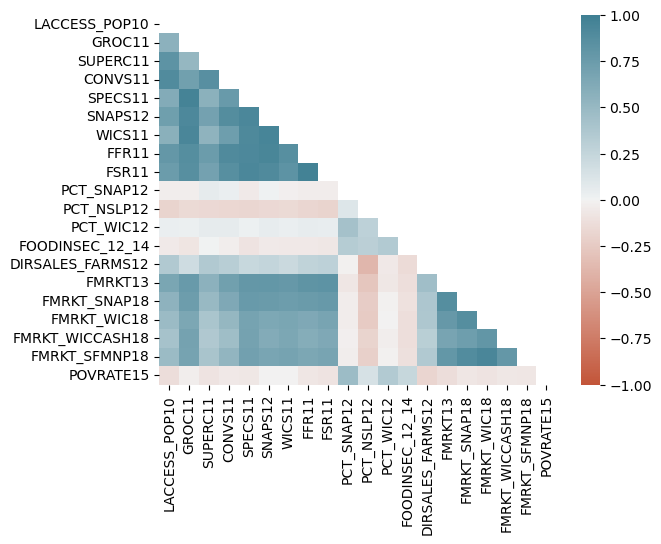

In [27]:
#Linear Correlation Heatmap
corrmat = fea_data_sub_numeric.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

#not sure why the error (in pink) is below. will figure that out.

In [28]:
#Nonlinear Correlation
fea_data_sub_numeric.corr(method='spearman').style.background_gradient(cmap='coolwarm') #default method is pearson

,LACCESS_POP10,GROC11,SUPERC11,CONVS11,SPECS11,SNAPS12,WICS11,FFR11,FSR11,PCT_SNAP12,PCT_NSLP12,PCT_WIC12,FOODINSEC_12_14,DIRSALES_FARMS12,FMRKT13,FMRKT_SNAP18,FMRKT_WIC18,FMRKT_WICCASH18,FMRKT_SFMNP18,POVRATE15
LACCESS_POP10,1.000000,0.753489,0.745609,0.794836,0.710690,0.777912,0.734918,0.819618,0.799352,0.001864,-0.271766,0.013715,-0.105168,0.530060,0.558759,0.471024,0.399801,0.313196,0.379084,-0.139907
GROC11,0.753489,1.000000,0.715867,0.874997,0.768686,0.892793,0.902539,0.881055,0.875509,0.093915,-0.350074,-0.060574,-0.147885,0.615680,0.665593,0.545540,0.483140,0.391409,0.449671,-0.107934
SUPERC11,0.745609,0.715867,1.000000,0.791411,0.682093,0.791717,0.750835,0.825729,0.779929,0.129444,-0.224881,0.021452,-0.010402,0.506423,0.548963,0.458599,0.373187,0.291937,0.361420,-0.062813
CONVS11,0.794836,0.874997,0.791411,1.000000,0.762804,0.954473,0.871458,0.930017,0.888963,0.207066,-0.283295,0.045757,-0.056499,0.620249,0.624311,0.522720,0.443514,0.354906,0.416074,-0.023908
SPECS11,0.710690,0.768686,0.682093,0.762804,1.000000,0.752951,0.736421,0.802578,0.825205,-0.036797,-0.351544,-0.096574,-0.194794,0.574707,0.644177,0.523066,0.475551,0.388539,0.433095,-0.231960
SNAPS12,0.777912,0.892793,0.791717,0.954473,0.752951,1.000000,0.899717,0.925470,0.865440,0.268977,-0.294361,0.070612,-0.054576,0.606887,0.616462,0.530986,0.459227,0.370527,0.438019,0.070352
WICS11,0.734918,0.902539,0.750835,0.871458,0.736421,0.899717,1.000000,0.868271,0.844896,0.145266,-0.293024,-0.043981,-0.117438,0.599772,0.642864,0.531856,0.480194,0.377632,0.454072,-0.051035
FFR11,0.819618,0.881055,0.825729,0.930017,0.802578,0.925470,0.868271,1.000000,0.927731,0.119699,-0.325161,0.013663,-0.095620,0.622833,0.654981,0.541778,0.467682,0.369425,0.436800,-0.110167
FSR11,0.799352,0.875509,0.779929,0.888963,0.825205,0.865440,0.844896,0.927731,1.000000,0.026501,-0.388473,-0.084496,-0.174499,0.655905,0.708928,0.574780,0.502431,0.404539,0.463957,-0.215766
PCT_SNAP12,0.001864,0.093915,0.129444,0.207066,-0.036797,0.268977,0.145266,0.119699,0.026501,1.000000,0.105944,0.529264,0.418030,0.019854,-0.057360,0.000795,0.024538,-0.009594,0.041234,0.529373


/opt/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:260: FutureWarning:

Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior



<Axes: >

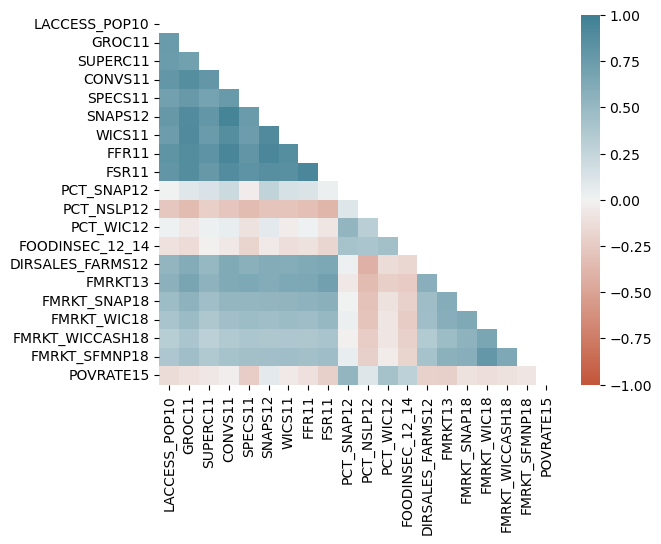

In [29]:
#Nonlinear Correlation Heatmap
corrmat = fea_data_sub_numeric.corr(method='spearman')
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

In [30]:
## Add in pair plots

#sns.pairplot(sns.load_dataset(fea_data_numeric[columns]))